<a href="https://colab.research.google.com/github/sonakshisharan/Machine_Learning/blob/main/Quant_Project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

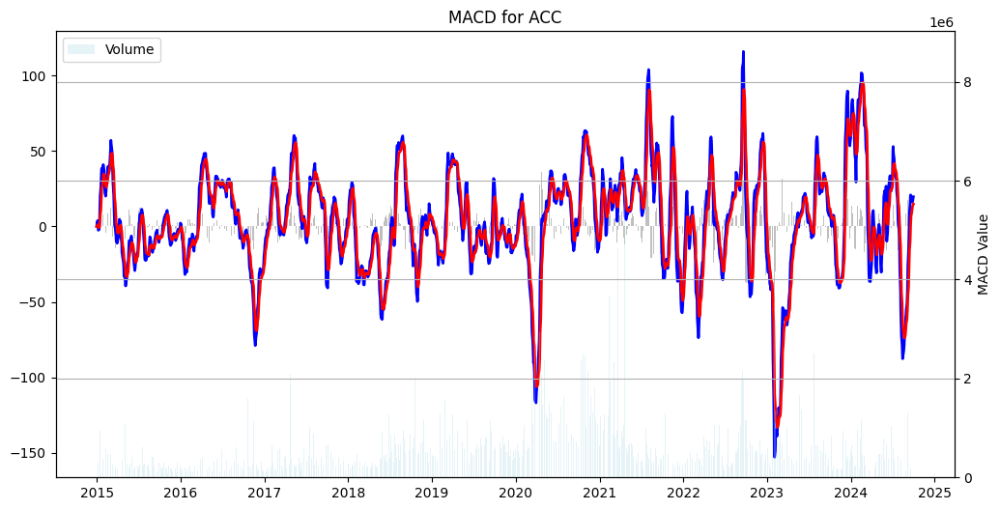

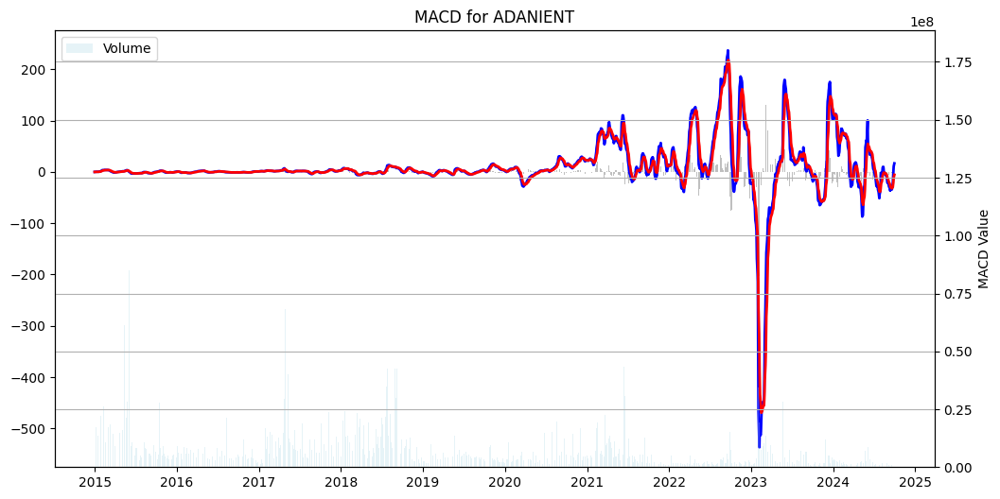

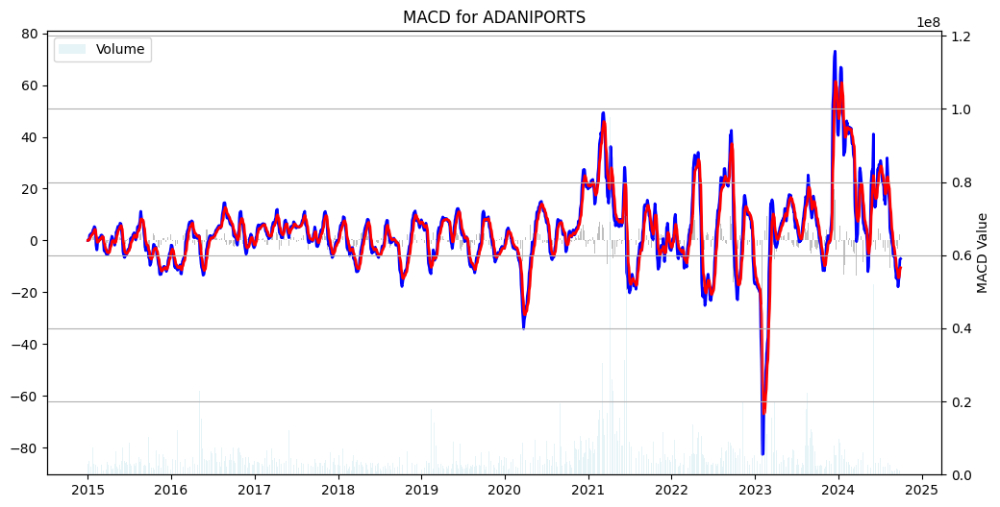

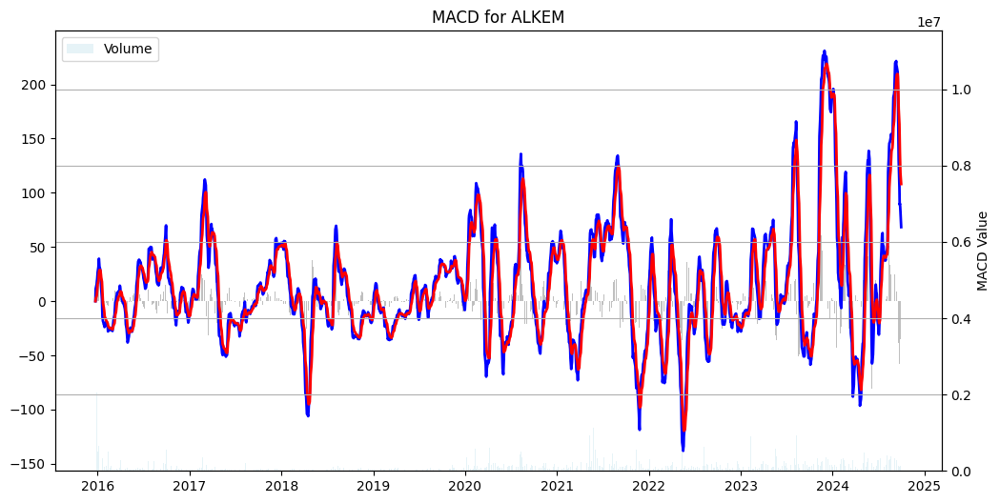

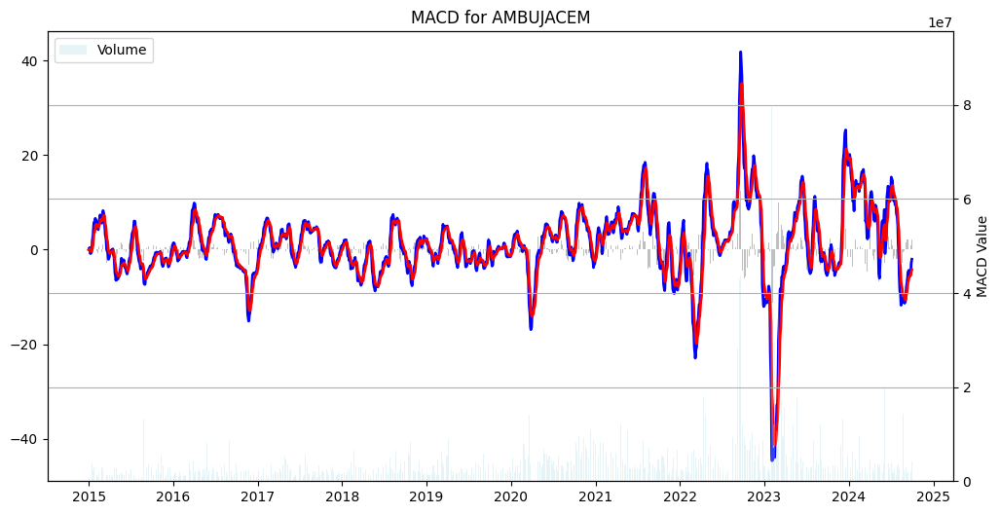

...

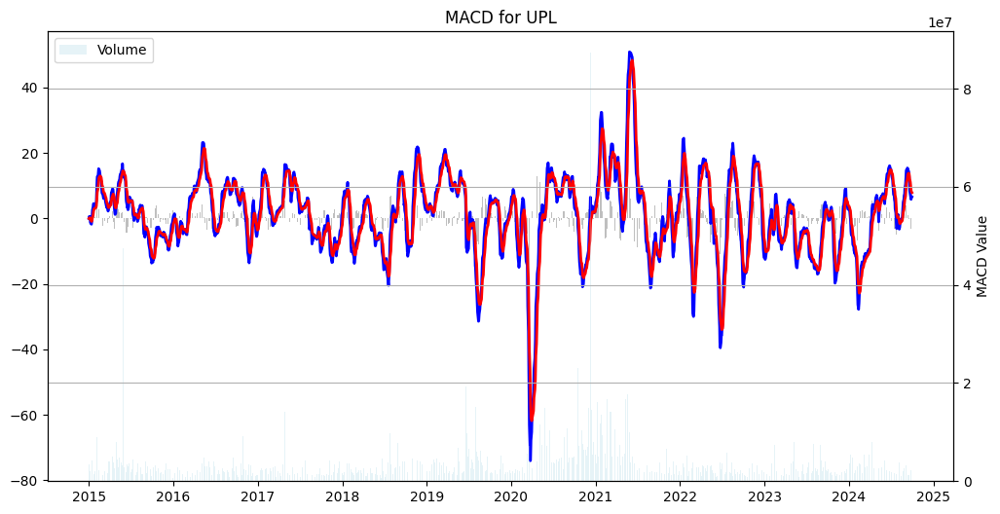

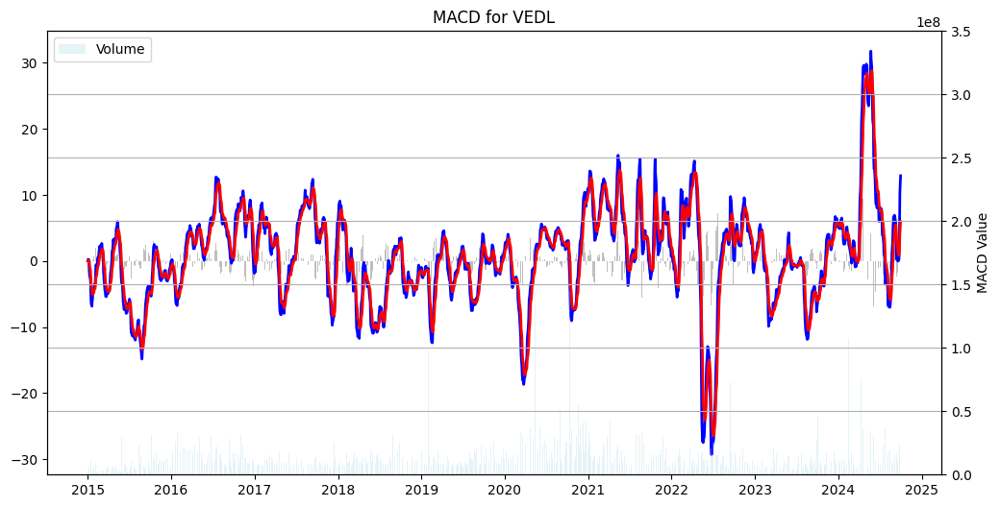

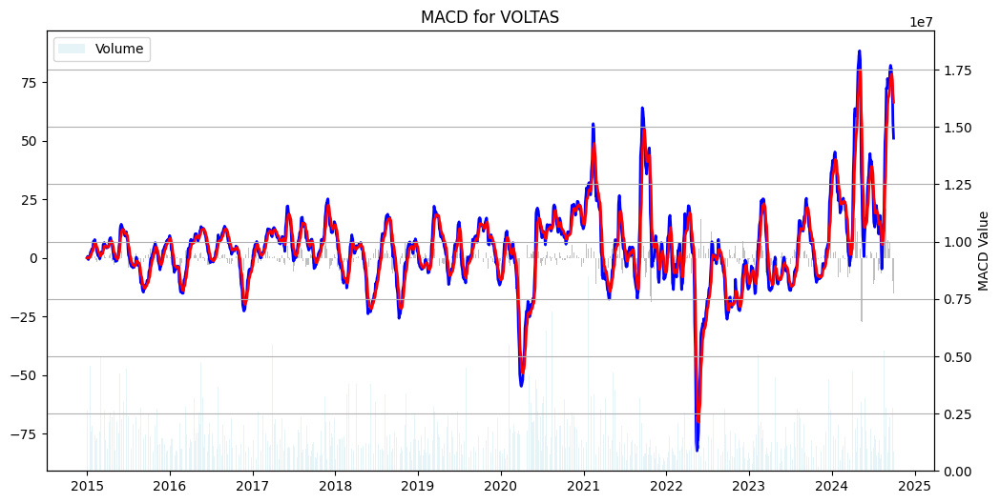

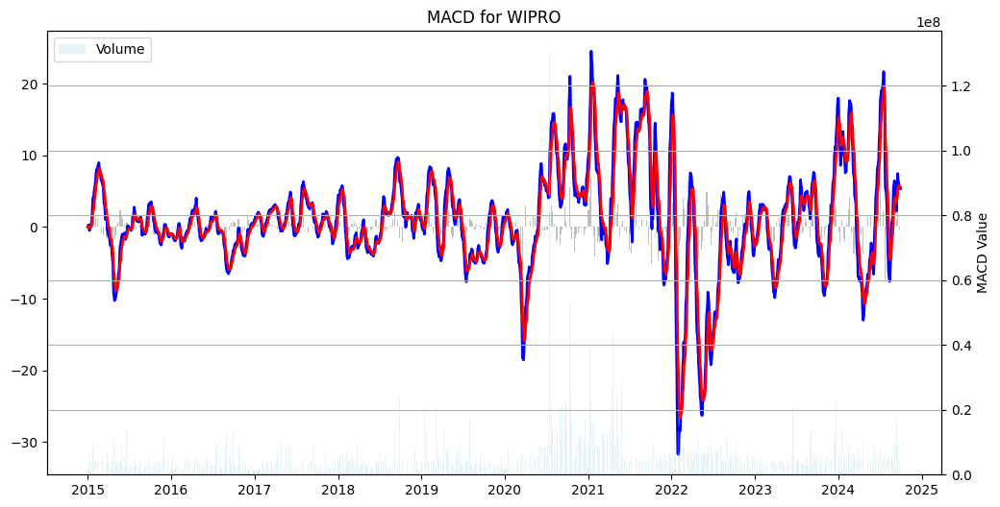

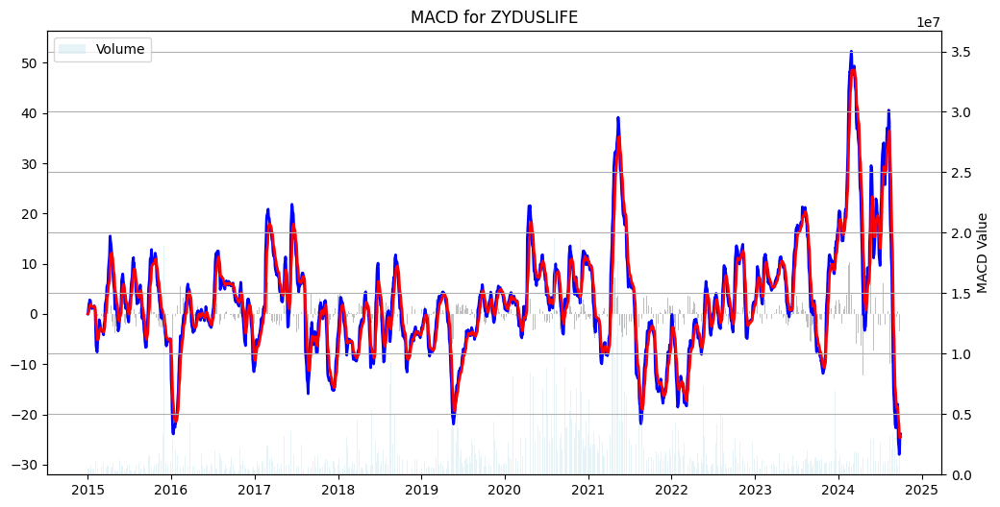

           symbol  level_1       date    close     volume       EMA_12  \
365062  ZYDUSLIFE   364434 2024-09-24  1051.55  1453214.0  1084.623306   
365063  ZYDUSLIFE   364592 2024-09-25  1063.45  1540510.0  1081.365874   
365064  ZYDUSLIFE   364750 2024-09-26  1068.00  1861553.0  1079.309586   
365065  ZYDUSLIFE   364908 2024-09-27  1075.95  2797238.0  1078.792727   
365066  ZYDUSLIFE   365066 2024-09-30  1068.55  2129069.0  1077.216922   

             EMA_26  MACD_Line  Signal_Line  MACD_Histogram  
365062  1112.608220 -27.984914   -23.208275       -4.776640  
365063  1108.966871 -27.600996   -24.086819       -3.514177  
365064  1105.932288 -26.622702   -24.593996       -2.028706  
365065  1103.711377 -24.918651   -24.658927       -0.259724  
365066  1101.106831 -23.889909   -24.505123        0.615215  


In [8]:


# Function to calculate the Exponential Moving Average (EMA)
def ema(data, period):
    return data.ewm(span=period, adjust=False).mean()

# Function to calculate the MACD, Signal Line, and Histogram for each company
def calculate_macd(df, short_window=12, long_window=26, signal_window=9):
    # Calculate short-term and long-term EMAs
    df['EMA_12'] = ema(df['close'], short_window)  # 12-day EMA
    df['EMA_26'] = ema(df['close'], long_window)   # 26-day EMA

    # Calculate the MACD line
    df['MACD_Line'] = df['EMA_12'] - df['EMA_26']

    # Calculate the Signal line (9-day EMA of the MACD line)
    df['Signal_Line'] = ema(df['MACD_Line'], signal_window)

    # Calculate the MACD Histogram
    df['MACD_Histogram'] = df['MACD_Line'] - df['Signal_Line']

    return df

df = pd.read_csv('fno_assignment.csv')


df['date'] = pd.to_datetime(df['date'])

# Group the data by company and applying the MACD calculation
grouped = df.groupby('symbol')


macd_results = grouped.apply(calculate_macd, include_groups=False).reset_index()


for company, data in macd_results.groupby('symbol'):
    plt.figure(figsize=(12, 6))
    plt.plot(data['date'], data['MACD_Line'], label='MACD Line', color='b', lw=2)
    plt.plot(data['date'], data['Signal_Line'], label='Signal Line', color='r', lw=2)
    plt.bar(data['date'], data['MACD_Histogram'], label='MACD Histogram', color='gray', alpha=0.5)

    # Optional: plot the volume on the same chart (or you can plot it separately)
    plt.twinx().bar(data['date'], data['volume'], label='Volume', color='lightblue', alpha=0.3)

    plt.title(f'MACD for {company}')
    plt.xlabel('Date')
    plt.ylabel('MACD Value')
    plt.legend(loc='upper left')
    plt.grid(True)
    plt.show()

# Optional: print the results for each company
print(macd_results.tail())


In [12]:
def calculate_rsi(df, period=14):
    delta = df['close'].diff(1)
    gain = delta.where(delta > 0, 0)
    loss = -delta.where(delta < 0, 0)

    avg_gain = ema(gain, period)
    avg_loss = ema(loss, period)

    rs = avg_gain / avg_loss
    df['RSI'] = 100 - (100 / (1 + rs))

    return df

In [14]:
def calculate_indicators(df):
    # Calculate MACD
    df = calculate_macd(df)

    # Calculate RSI
    df = calculate_rsi(df)

    # Calculate the 20-day EMA of Volume for volume conditions
    df['Volume_MA'] = ema(df['volume'], 20)

    # Entry Signal (Short): MACD crosses below Signal line AND volume is above the moving average of volume
    df['Short_Signal'] = (df['MACD_Line'] < df['Signal_Line']) & (df['volume'] > df['Volume_MA'])

    # Exit Signal (Cover Short): MACD crosses above Signal line OR any other exit criteria
    df['Exit_Signal'] = (df['MACD_Line'] > df['Signal_Line'])
    return df

In [15]:
# Grouping the data by company and apply the indicator calculation (MACD, RSI, signals), as there are different companies
grouped = df.groupby('symbol')

#Apply indicator calculation to each company's data , exclude group columns in the operation
results = grouped.apply(calculate_indicators, include_groups=False).reset_index(drop=True)

<ipython-input-52-2848f22788db>:11: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  results = grouped.apply(calculate_indicators).reset_index(drop=True)


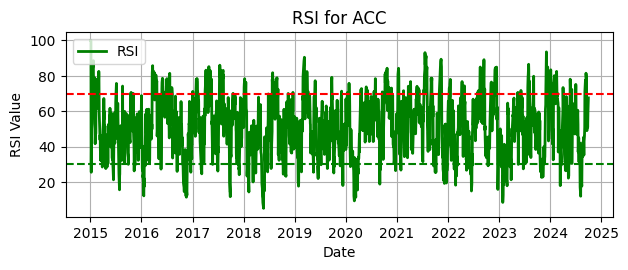

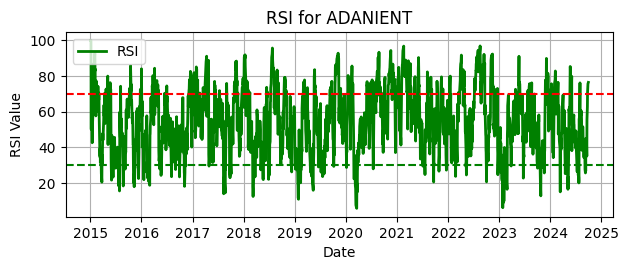

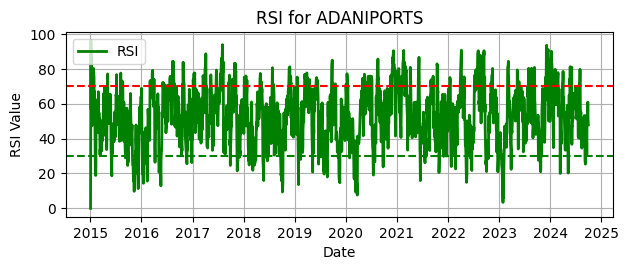

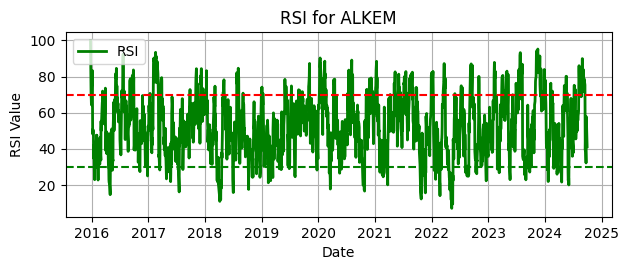

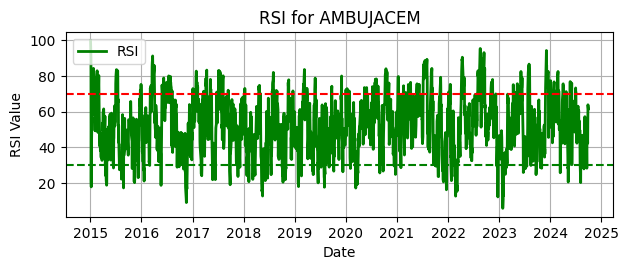

...

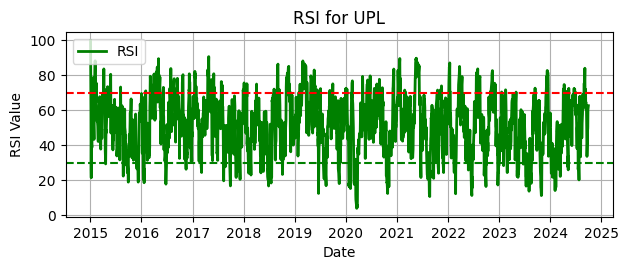

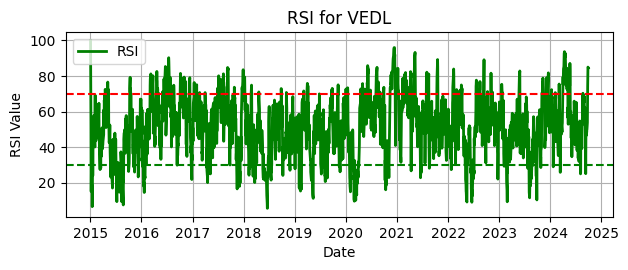

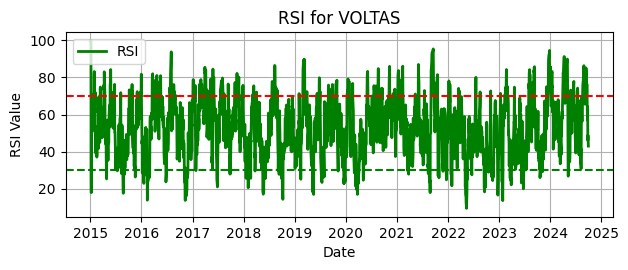

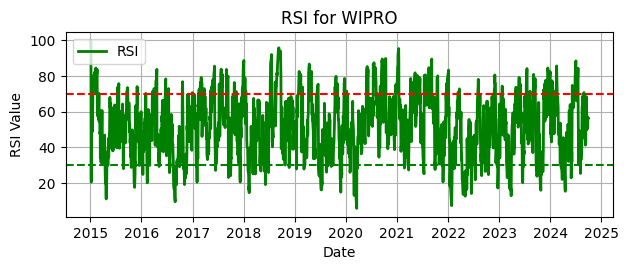

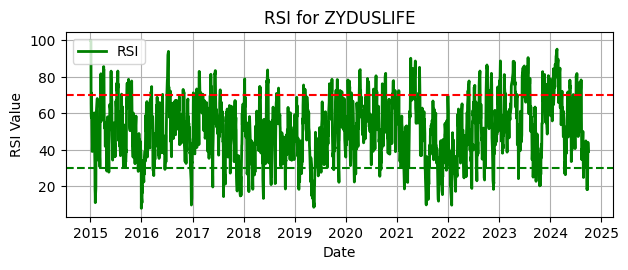

In [52]:

df['date'] = pd.to_datetime(df['date'])


grouped = df.groupby('symbol')

# Apply indicator calculation to each company's/symbol's data
results = grouped.apply(calculate_indicators).reset_index(drop=True)

# Plotting MACD and RSI for each company
for company, data in results.groupby('symbol'):
  plt.subplot(2, 1, 2)
  plt.plot(data['date'], data['RSI'], label='RSI', color='g', lw=2)
  plt.axhline(70, color='red', linestyle='--')
  plt.axhline(30, color='green', linestyle='--')
  plt.title(f'RSI for {company}')
  plt.xlabel('Date')
  plt.ylabel('RSI Value')
  plt.legend(loc='upper left')
  plt.grid(True)

  plt.tight_layout()
  plt.show()

In [16]:
def calculate_indicators(df):
    # Calculate MACD for the company's data
    df = calculate_macd(df)

    # Calculate RSI for the company's data
    df = calculate_rsi(df)

    # Calculate the 20-day EMA of Volume for volume conditions
    df['Volume_MA'] = ema(df['volume'], 20)

    # Entry Signal (Short): MACD crosses below Signal line AND volume is above the moving average of volume
    df['Short_Signal'] = (df['MACD_Line'] < df['Signal_Line']) & (df['volume'] > df['Volume_MA'])

    # Exit Signal (Cover Short): MACD crosses above Signal line OR any other exit criteria
    df['Exit_Signal'] = (df['MACD_Line'] > df['Signal_Line'])
    return df


In [17]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt


Backtesting for ZYDUSLIFE...
Short Signals: 8, Exit Signals: 8


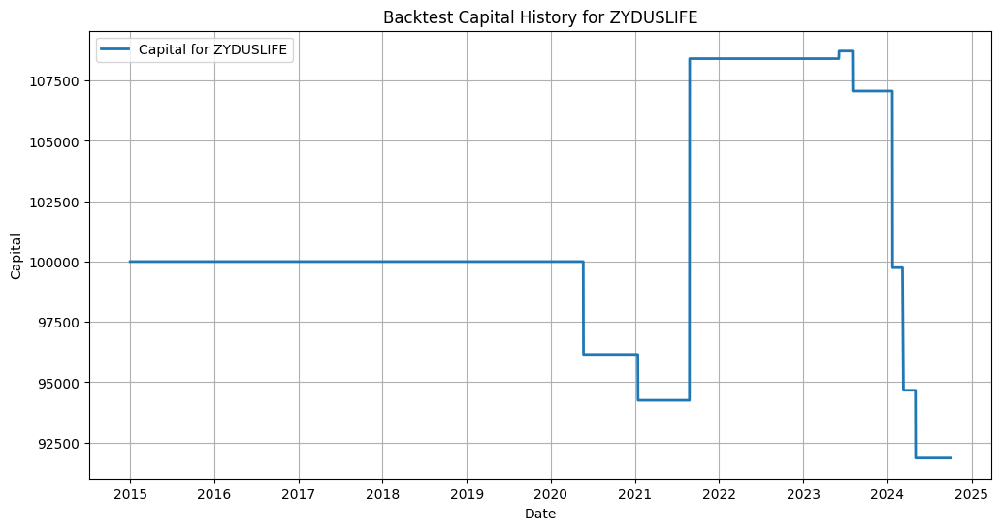


Performance Summary:
ZYDUSLIFE:
  Total Return (%): -8.14
  Sharpe Ratio: -2.17
  Max Drawdown (%): 15.51
  Final Capital: 91856.17


In [22]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt




# Function to calculate MACD
def calculate_macd(df, short_window=12, long_window=26, signal_window=9):
    df['EMA_Short'] = df['close'].ewm(span=short_window, adjust=False).mean()
    df['EMA_Long'] = df['close'].ewm(span=long_window, adjust=False).mean()
    df['MACD_Line'] = df['EMA_Short'] - df['EMA_Long']
    df['Signal_Line'] = df['MACD_Line'].ewm(span=signal_window, adjust=False).mean()
    return df

# Function to calculate RSI
def calculate_rsi(df, period=14):
    delta = df['close'].diff()
    gain = (delta.where(delta > 0, 0)).rolling(window=period).mean()
    loss = (-delta.where(delta < 0, 0)).rolling(window=period).mean()
    rs = gain / loss
    df['RSI'] = 100 - (100 / (1 + rs))
    return df

# Function to determine Short and Exit Signals
def add_signals(df):
    df['Short_Signal'] = (df['MACD_Line'] < df['Signal_Line']) & (df['RSI'] > 70)
    df['Exit_Signal'] = (df['MACD_Line'] > df['Signal_Line'])
    return df

# Main function to process data and calculate indicators
def process_data(df):
    df = calculate_macd(df)
    df = calculate_rsi(df)
    df = add_signals(df)
    return df

# Backtesting function with performance statistics
def backtest_macd_rsi_strategy(df, initial_capital=100000):
    position = 0
    entry_price = 0
    capital = initial_capital
    capital_history = [initial_capital]
    returns = []

    # Track number of trades
    num_short_signals = 0
    num_exit_signals = 0

    for i in range(1, len(df)):
        # Entry signal (enter short)
        if df['Short_Signal'].iloc[i] and position == 0:
            position = 1
            entry_price = df['close'].iloc[i]
            num_short_signals += 1  # Count short signals

        # Exit signal (cover short)
        elif df['Exit_Signal'].iloc[i] and position == 1:
            exit_price = df['close'].iloc[i]
            pnl = (entry_price - exit_price) / entry_price  # Calculate profit/loss
            position = 0
            capital += capital * pnl  # Update capital based on PnL
            returns.append(pnl)  # Record return
            num_exit_signals += 1  # Count exit signals

        # Update capital history when there's no trade
        capital_history.append(capital)

    # Print number of trades executed
    print(f"Short Signals: {num_short_signals}, Exit Signals: {num_exit_signals}")

    capital_history_df = pd.DataFrame({
        'Date': df['date'],
        'Capital': capital_history
    })

    # Calculate performance statistics
    total_return = (capital - initial_capital) / initial_capital
    mean_return = np.mean(returns) if len(returns) > 0 else 0
    std_return = np.std(returns) if len(returns) > 0 else 0
    sharpe_ratio = mean_return / std_return * np.sqrt(252) if std_return != 0 else 0
    max_drawdown = (np.max(capital_history) - np.min(capital_history)) / np.max(capital_history)

    performance = {
        'Total Return (%)': total_return * 100,
        'Sharpe Ratio': sharpe_ratio,
        'Max Drawdown (%)': max_drawdown * 100,
        'Final Capital': capital
    }

    return capital_history_df, performance

# Process the data for each company and backtest
grouped = data.groupby('symbol')
performance_summary = {}

# Iterate over each company's data and backtest
for company_name, company_data in grouped:
    print(f"\nBacktesting for {company_name}...")

    # Process the selected company's data
    company_data = process_data(company_data)

    # Backtest the selected company's data
    capital_history, performance = backtest_macd_rsi_strategy(company_data)

    # Store performance metrics in summary
    performance_summary[company_name] = performance

    # Plot the capital over time for the current company
    plt.figure(figsize=(12, 6))
    plt.plot(capital_history['Date'], capital_history['Capital'], label=f'Capital for {company_name}', lw=2)
    plt.title(f'Backtest Capital History for {company_name}')
    plt.xlabel('Date')
    plt.ylabel('Capital')
    plt.legend(loc='upper left')
    plt.grid(True)
    plt.show()

# Display performance metrics for all companies
print("\nPerformance Summary:")
for company, metrics in performance_summary.items():
    print(f"{company}:")
    for metric, value in metrics.items():
        print(f"  {metric}: {value:.2f}")



### **Short Strategy Builder**

#### 1. **Brief Introduction**
Short-selling is a tradinng strategy where investors profit from a decline in the stock's price.This strategy involves borrowing shares of the stock ,selling them at a current market price and then buying them later at a lower prices to return to the lender
#### 2. **What to trade**


- **Overbought Conditions**: Utilizing technical indicators such as the Relative Strength Index (RSI), which measures the speed and change of price movements, traders can identify stocks that may be overbought and thus due for a correction. A common threshold for RSI is above 70.RSI,is a key indicator which measures the speed and change of price movements,stocks can identify stocks that may be overbought ,oversold,Values>70 is overbought ,Values less than 30 is oversold.In short selling , the rsi >70 .

- **Momentum Indicators**: Moving Average Convergence Divergence (MACD) can help identify weakening momentum in stocks. A bearish MACD crossover or divergence can signal that a stock's upward price movement is losing strength.When MACD crossess below  the signal line then it is short selling

- **Financial Ratios**: ratios like Price-to-Earnings (P/E), Price-to-Book (P/B), and Debt-to-Equity (D/E) can help into overvaluation.High valuations when compared to peers to historical averages may indicate that it is short-selling


#### 3.Entry Signal
 The entry consitions for the short strategy will involve a combination of technical indicators and market sentiment analysis

- **Technical Indicators **:
  - **MACD Crossover**:A  bearish crossover of the MACD line below the signal can be a strong entry signal
  - **RSI Threshold**: If the RSI is above 70,indicating overbought conditions,thi may trigger a short position
  
- **Volume Confirmation**:A significant increase in the trading volume on the day the stock triggers the short signal can confirm the strength of the downward move.

- **Candlestick Patterns**:.Patterns like Bearish engulfing or shooting stars may indicate potential price reversals

#### 4.Exit Signal
Conditions for exiting a short trade will include:

- **Technical Reversal**:If the MACD line crosses back above the signal line,this may indicate a reverse in momentum,which prompts a exits from the short position.

- **Profit Target**:Setting a predefined profit target,such as percentage decline from the entry price(10%),this will help in lock gains

- **Stop-Loss Order**:Establishing a stop-loss order at a percentage above the entry price will limit potential loss in case the trade goes against the position


#### 5.Risk management
 The following strategies will be implemented:

- **Stop loss settings**: A stop-loss order will be placed above the entry price to limit losses.This could be a fixed percentage or a volatility-based measure.


- **Rebalancing frequency**:Regularly review and rebalance the portfolio to adjust for the changes in risk exposure or market conditions.This could be done weekly or monthly .

- **Diversification of portfoio **:Avoid concentrating short positions in a single sector or stock to reduce the risk.Spreading out positions accross various industries , as it may happen that a specific industry going a bullish/bearish condition due to any macroeconomic reason .

- **Regular Performance Review**:Analysing the performance of the short strategy on a regular basis will help identify areas for improvement and ensure that the strategy reamins aligned with market conditions

---

### Summary
This short -selling strategy focuses on exploiting market inefficiencies thorugh systematic entry and exit signals based on technical indiactors and fundamental analysis.Effective risk management practices are also done to protect against potential lossess, ensurng that the strategy remains sustainable in various market conditions.By continually assessing and refining the approach traders can enhance their chances of success in short-selling.